In [1]:
import sys
sys.path.append(".")
sys.path.append("..")
sys.path.append("../..")

In [2]:
from PIL import Image
import torch
import numpy as np
import matplotlib.pyplot as plt
from utils.image_utils import *
from model.my_diffusers.models import AutoencoderKL_Pretrained 

In [3]:
device = torch.device('cuda:4') if torch.cuda.is_available() else torch.device('cpu')
vae = AutoencoderKL_Pretrained.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="vae").to(device)

Cannot initialize model with low cpu memory usage because `accelerate` was not found in the environment. Defaulting to `low_cpu_mem_usage=False`. It is strongly recommended to install `accelerate` for faster and less memory-intense model loading. You can do so with: 
```
pip install accelerate
```
.


In [4]:
from typing import Union, Optional, Tuple
import torch
import torch.nn.functional as F
from utils.warp_utils.torchgeometry.core.conversions import deg2rad
from utils.warp_utils.torchgeometry.core.homography_warper import homography_warp

class SO2_warper():
    def __init__(self):
        pass

    # Code from
    # https://kornia.readthedocs.io/en/v0.1.2/_modules/torchgeometry/core/imgwarp.html

    def get_perspective_transform(self, src, dst):
        r"""Calculates a perspective transform from four pairs of the corresponding
        points.

        The function calculates the matrix of a perspective transform so that:

        .. math ::

            \begin{bmatrix}
            t_{i}x_{i}^{'} \\
            t_{i}y_{i}^{'} \\
            t_{i} \\
            \end{bmatrix}
            =
            \textbf{map_matrix} \cdot
            \begin{bmatrix}
            x_{i} \\
            y_{i} \\
            1 \\
            \end{bmatrix}

        where

        .. math ::
            dst(i) = (x_{i}^{'},y_{i}^{'}), src(i) = (x_{i}, y_{i}), i = 0,1,2,3

        Args:
            src (Tensor): coordinates of quadrangle vertices in the source image.
            dst (Tensor): coordinates of the corresponding quadrangle vertices in
                the destination image.

        Returns:
            Tensor: the perspective transformation.

        Shape:
            - Input: :math:`(B, 4, 2)` and :math:`(B, 4, 2)`
            - Output: :math:`(B, 3, 3)`
        """
        if not torch.is_tensor(src):
            raise TypeError("Input type is not a torch.Tensor. Got {}"
                            .format(type(src)))
        if not torch.is_tensor(dst):
            raise TypeError("Input type is not a torch.Tensor. Got {}"
                            .format(type(dst)))
        if not src.shape[-2:] == (4, 2):
            raise ValueError("Inputs must be a Bx4x2 tensor. Got {}"
                             .format(src.shape))
        if not src.shape == dst.shape:
            raise ValueError("Inputs must have the same shape. Got {}"
                             .format(dst.shape))
        if not (src.shape[0] == dst.shape[0]):
            raise ValueError("Inputs must have same batch size dimension. Got {}"
                             .format(src.shape, dst.shape))

        def ax(p, q):
            ones = torch.ones_like(p)[..., 0:1]
            zeros = torch.zeros_like(p)[..., 0:1]
            return torch.cat(
                [p[:, 0:1], p[:, 1:2], ones, zeros, zeros, zeros,
                 -p[:, 0:1] * q[:, 0:1], -p[:, 1:2] * q[:, 0:1]
                 ], dim=1)

        def ay(p, q):
            ones = torch.ones_like(p)[..., 0:1]
            zeros = torch.zeros_like(p)[..., 0:1]
            return torch.cat(
                [zeros, zeros, zeros, p[:, 0:1], p[:, 1:2], ones,
                 -p[:, 0:1] * q[:, 1:2], -p[:, 1:2] * q[:, 1:2]], dim=1)
        # we build matrix A by using only 4 point correspondence. The linear
        # system is solved with the least square method, so here
        # we could even pass more correspondence
        p = []
        p.append(ax(src[:, 0], dst[:, 0]))
        p.append(ay(src[:, 0], dst[:, 0]))

        p.append(ax(src[:, 1], dst[:, 1]))
        p.append(ay(src[:, 1], dst[:, 1]))

        p.append(ax(src[:, 2], dst[:, 2]))
        p.append(ay(src[:, 2], dst[:, 2]))

        p.append(ax(src[:, 3], dst[:, 3]))
        p.append(ay(src[:, 3], dst[:, 3]))

        # A is Bx8x8
        A = torch.stack(p, dim=1)

        # b is a Bx8x1
        b = torch.stack([
            dst[:, 0:1, 0], dst[:, 0:1, 1],
            dst[:, 1:2, 0], dst[:, 1:2, 1],
            dst[:, 2:3, 0], dst[:, 2:3, 1],
            dst[:, 3:4, 0], dst[:, 3:4, 1],
        ], dim=1)

        # solve the system Ax = b
        # X, LU = torch.gesv(b, A) # Outdated change to solve 2023.07.17 Jaihoon
        X, LU = torch.solve(b, A)

        # create variable to return
        batch_size = src.shape[0]
        M = torch.ones(batch_size, 9, device=src.device, dtype=src.dtype)
        M[..., :8] = torch.squeeze(X, dim=-1)

        return M.view(-1, 3, 3)  # Bx3x3
    
    def warp_perspective(self, 
                         src, 
                         M, 
                         dsize, 
                         interpolation_mode='bilinear', 
                         padding_mode=None,
                         border_value=0):
        
        r"""Applies a perspective transformation to an image.

        The function warp_perspective transforms the source image using
        the specified matrix:

        .. math::
            \text{dst} (x, y) = \text{src} \left(
            \frac{M_{11} x + M_{12} y + M_{13}}{M_{31} x + M_{32} y + M_{33}} ,
            \frac{M_{21} x + M_{22} y + M_{23}}{M_{31} x + M_{32} y + M_{33}}
            \right )

        Args:
            src (torch.Tensor): input image.
            M (Tensor): transformation matrix.
            dsize (tuple): size of the output image (height, width).

        Returns:
            Tensor: the warped input image.

        Shape:
            - Input: :math:`(B, C, H, W)` and :math:`(B, 3, 3)`
            - Output: :math:`(B, C, H, W)`

        .. note::
           See a working example `here <https://github.com/arraiy/torchgeometry/
           blob/master/examples/warp_perspective.ipynb>`_.
        """
        if not torch.is_tensor(src):
            raise TypeError("Input src type is not a torch.Tensor. Got {}"
                            .format(type(src)))
        if not torch.is_tensor(M):
            raise TypeError("Input M type is not a torch.Tensor. Got {}"
                            .format(type(M)))
        if not len(src.shape) == 4:
            raise ValueError("Input src must be a BxCxHxW tensor. Got {}"
                             .format(src.shape))
        if not (len(M.shape) == 3 or M.shape[-2:] == (3, 3)):
            raise ValueError("Input M must be a Bx3x3 tensor. Got {}"
                             .format(src.shape))
        # launches the warper
        return self.transform_warp_impl(src, M, (src.shape[-2:]), dsize, interpolation_mode, padding_mode)

    def get_rotation_matrix2d(self, center, angle, scale, translate=None):
        r"""Calculates an affine matrix of 2D rotation.

        The function calculates the following matrix:

        .. math::
            \begin{bmatrix}
                \alpha & \beta & (1 - \alpha) \cdot \text{x}
                - \beta \cdot \text{y} \\
                -\beta & \alpha & \beta \cdot \text{x}
                + (1 - \alpha) \cdot \text{y}
            \end{bmatrix}

        where

        .. math::
            \alpha = \text{scale} \cdot cos(\text{angle}) \\
            \beta = \text{scale} \cdot sin(\text{angle})

        The transformation maps the rotation center to itself
        If this is not the target, adjust the shift.

        Args:
            center (Tensor): center of the rotation in the source image.
            angle (Tensor): rotation angle in degrees. Positive values mean
                counter-clockwise rotation (the coordinate origin is assumed to
                be the top-left corner).
            scale (Tensor): isotropic scale factor.

        Returns:
            Tensor: the affine matrix of 2D rotation.

        Shape:
            - Input: :math:`(B, 2)`, :math:`(B)` and :math:`(B)`
            - Output: :math:`(B, 2, 3)`

        Example:
            >>> center = torch.zeros(1, 2)
            >>> scale = torch.ones(1)
            >>> angle = 45. * torch.ones(1)
            >>> M = tgm.get_rotation_matrix2d(center, angle, scale)
            tensor([[[ 0.7071,  0.7071,  0.0000],
                    [-0.7071,  0.7071,  0.0000]]])
        """
        if not torch.is_tensor(center):
            raise TypeError("Input center type is not a torch.Tensor. Got {}"
                            .format(type(center)))
        if not torch.is_tensor(angle):
            raise TypeError("Input angle type is not a torch.Tensor. Got {}"
                            .format(type(angle)))
        if not torch.is_tensor(scale):
            raise TypeError("Input scale type is not a torch.Tensor. Got {}"
                            .format(type(scale)))
        if not (len(center.shape) == 2 and center.shape[1] == 2):
            raise ValueError("Input center must be a Bx2 tensor. Got {}"
                            .format(center.shape))
        if not len(angle.shape) == 1:
            raise ValueError("Input angle must be a B tensor. Got {}"
                            .format(angle.shape))
        if not len(scale.shape) == 1:
            raise ValueError("Input scale must be a B tensor. Got {}"
                            .format(scale.shape))
        if not (center.shape[0] == angle.shape[0] == scale.shape[0]):
            raise ValueError("Inputs must have same batch size dimension. Got {}"
                            .format(center.shape, angle.shape, scale.shape))
        # convert angle and apply scale
        angle_rad = deg2rad(angle)
        alpha = torch.cos(angle_rad) * scale
        beta = torch.sin(angle_rad) * scale

        # unpack the center to x, y coordinates
        x, y = center[..., 0], center[..., 1]

        # Add translation 2023.07.17
        if translate != None:
            tx, ty = translate[..., 0], translate[..., 1]
        else:
            translate = torch.zeros_like(center)
            tx, ty = translate[..., 0], translate[..., 1]
            
        # create output tensor
        batch_size, _ = center.shape
        M = torch.zeros(batch_size, 2, 3, device=center.device, dtype=center.dtype)
        M[..., 0, 0] = alpha
        M[..., 0, 1] = beta
        M[..., 0, 2] = (1. - alpha) * x - beta * y + tx
        M[..., 1, 0] = -beta
        M[..., 1, 1] = alpha
        M[..., 1, 2] = beta * x + (1. - alpha) * y + ty
        return M


    def warp_affine(self, 
                    src: torch.Tensor,
                    M: torch.Tensor,
                    dsize: Tuple[int, int],
                    interpolation_mode: Optional[str] = 'bilinear',
                    padding_mode: Optional[str] = 'zeros',
                    verbose: bool = False) -> torch.Tensor:
        r"""Applies an affine transformation to a tensor.

        The function warp_affine transforms the source tensor using
        the specified matrix:

        .. math::
            \text{dst}(x, y) = \text{src} \left( M_{11} x + M_{12} y + M_{13} ,
            M_{21} x + M_{22} y + M_{23} \right )

        Args:
            src (torch.Tensor): input tensor of shape :math:`(B, C, H, W)`.
            M (torch.Tensor): affine transformation of shape :math:`(B, 2, 3)`.
            dsize (Tuple[int, int]): size of the output image (height, width).
            mode (Optional[str]): interpolation mode to calculate output values
            'bilinear' | 'nearest'. Default: 'bilinear'.
            padding_mode (Optional[str]): padding mode for outside grid values
            'zeros' | 'border' | 'reflection'. Default: 'zeros'.

        Returns:
            torch.Tensor: the warped tensor.

        Shape:
            - Output: :math:`(B, C, H, W)`

        .. note::
        See a working example `here <https://github.com/arraiyopensource/
        torchgeometry/blob/master/docs/source/warp_affine.ipynb>`__.
        """
        if not torch.is_tensor(src):
            raise TypeError("Input src type is not a torch.Tensor. Got {}"
                            .format(type(src)))
        if not torch.is_tensor(M):
            raise TypeError("Input M type is not a torch.Tensor. Got {}"
                            .format(type(M)))
        if not len(src.shape) == 4:
            raise ValueError("Input src must be a BxCxHxW tensor. Got {}"
                            .format(src.shape))
        if not (len(M.shape) == 3 or M.shape[-2:] == (2, 3)):
            raise ValueError("Input M must be a Bx2x3 tensor. Got {}"
                            .format(src.shape))
            
        # we generate a 3x3 transformation matrix from 2x3 affine
        M_3x3: torch.Tensor = F.pad(M, (0, 0, 0, 1, 0, 0), mode="constant", value=0)
            
        M_3x3[:, 2, 2] += 1.0
        

        # launches the warper
        return self.transform_warp_impl(src, M_3x3, (src.shape[-2:]), dsize, interpolation_mode, padding_mode, verbose)

    def transform_warp_impl(self,
                            src, 
                            dst_pix_trans_src_pix, 
                            dsize_src, 
                            dsize_dst, 
                            interpolation_mode, 
                            padding_mode,
                            verbose):
        """Compute the transform in normalized cooridnates and perform the warping.
        """
        dst_norm_trans_dst_norm = self.dst_norm_to_dst_norm(dst_pix_trans_src_pix, dsize_src, dsize_dst, verbose)
        if verbose:
            print("dst_norm_trans_dst_norm", dst_norm_trans_dst_norm)
        
        return homography_warp(patch_src=src, 
                            dst_homo_src=torch.inverse(dst_norm_trans_dst_norm), 
                            dsize=dsize_dst, 
                            mode=interpolation_mode, 
                            padding_mode=padding_mode,
                            normalized_coordinates=True,
                            verbose=verbose)

    def dst_norm_to_dst_norm(self, dst_pix_trans_src_pix, dsize_src, dsize_dst, verbose):
        # source and destination sizes
        src_h, src_w = dsize_src
        dst_h, dst_w = dsize_dst
        
        # the devices and types
        device = dst_pix_trans_src_pix.device
        dtype = dst_pix_trans_src_pix.dtype
        
        # compute the transformation pixel/norm for src/dst
        src_norm_trans_src_pix = self.normal_transform_pixel(src_h, src_w).to(device).to(dtype)
        src_pix_trans_src_norm = torch.inverse(src_norm_trans_src_pix)
        dst_norm_trans_dst_pix = self.normal_transform_pixel(dst_h, dst_w).to(device).to(dtype)
        
        if verbose:
            print("src_norm_trans_src_pix", src_norm_trans_src_pix)
            print("src_pix_trans_src_norm", src_pix_trans_src_norm)
            print("dst_norm_trans_dst_pix", dst_norm_trans_dst_pix)

        # compute chain transformations
        dst_norm_trans_src_norm = torch.matmul(
                dst_norm_trans_dst_pix, torch.matmul(
                dst_pix_trans_src_pix, src_pix_trans_src_norm))
        
        return dst_norm_trans_src_norm

    def normal_transform_pixel(self, height, width):

        tr_mat = torch.Tensor([[1.0, 0.0, -1.0],
                            [0.0, 1.0, -1.0],
                            [0.0, 0.0, 1.0]])  # 1x3x3

        tr_mat[0, 0] = tr_mat[0, 0] * 2.0 / (width - 1.0)
        tr_mat[1, 1] = tr_mat[1, 1] * 2.0 / (height - 1.0)

        tr_mat = tr_mat.unsqueeze(0)

        return tr_mat

warper = SO2_warper()

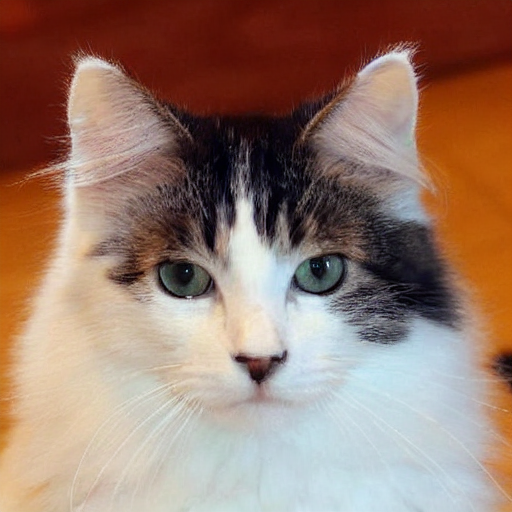

In [5]:
img = Image.open("/home/jh27kim/warp_latent/dataset/afhq/val/cat/image/flickr_cat_000008.jpg")
img = (np.array(img) / 255.0).astype(np.float32)
img = torch.tensor(img).permute(2, 0, 1).unsqueeze(0).to(device)
latent = image2latent(img, vae)
torch_to_pil(latent2image(latent, vae))

In [6]:
test_latent = torch.linspace(1, 9, 9).to(device)
test_latent = test_latent.view(1, 1, 3, 3)
print("source latent", test_latent)

angle = (torch.ones(1) * 90).to(device)
scale = torch.ones(1).to(device)
center = torch.ones(1, 2)
center[..., 0] = test_latent.shape[3] / 2  # x
center[..., 1] = test_latent.shape[2] / 2  # y

rigid_mat = warper.get_rotation_matrix2d(center=center.to(device), 
                                          angle=angle.to(device), 
                                          scale=scale.to(device))

_, _, src_h, src_w = test_latent.shape
print(rigid_mat, src_h)
warped_latent = warper.warp_affine(test_latent, 
                                   rigid_mat, 
                                   dsize=(src_h, src_w), 
                                   interpolation_mode="nearest", 
                                   padding_mode="zeros")

print("warped_latent", warped_latent)

source latent tensor([[[[1., 2., 3.],
          [4., 5., 6.],
          [7., 8., 9.]]]], device='cuda:4')
tensor([[[-4.3711e-08,  1.0000e+00,  0.0000e+00],
         [-1.0000e+00, -4.3711e-08,  3.0000e+00]]], device='cuda:4') 3
warped_latent tensor([[[[0., 0., 0.],
          [3., 6., 9.],
          [2., 5., 8.]]]], device='cuda:4')


/home/jh27kim/miniconda3/envs/diffusion_inv/lib/python3.8/site-packages/torch/functional.py:568: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  /opt/conda/conda-bld/pytorch_1646755903507/work/aten/src/ATen/native/TensorShape.cpp:2228.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


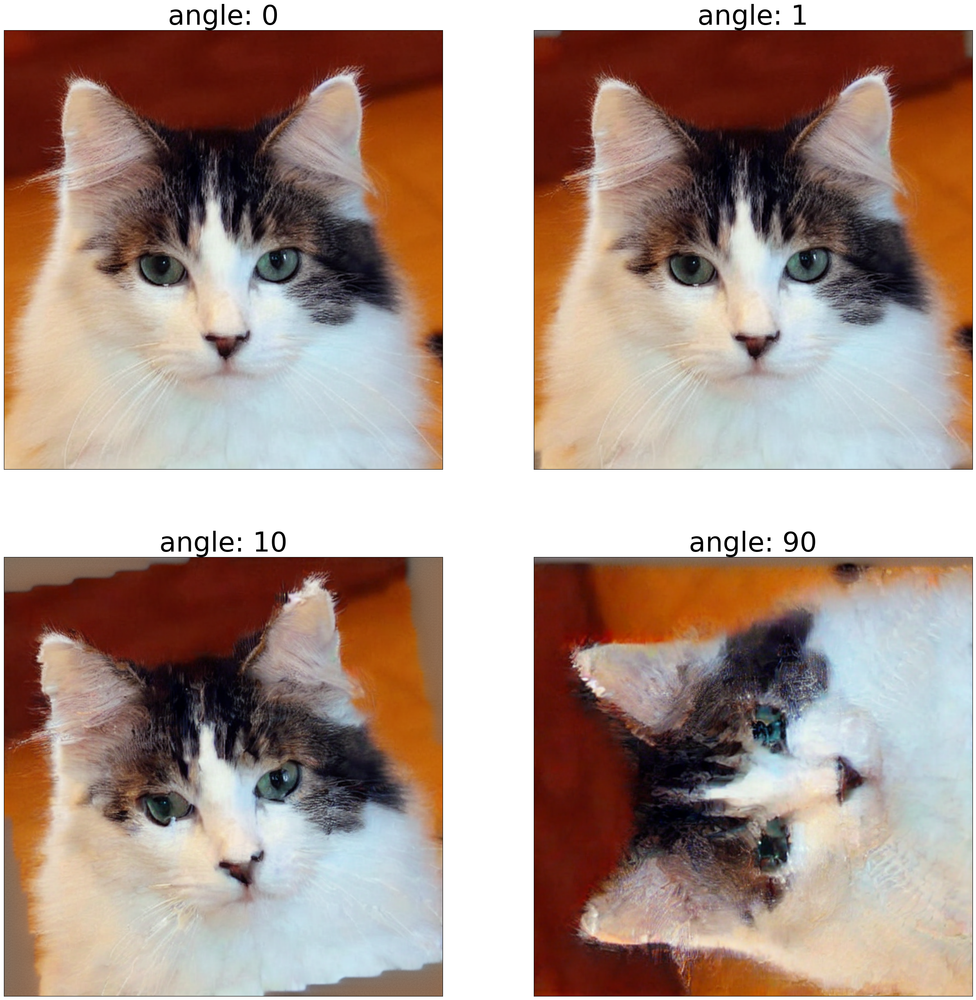

In [7]:
# Test padding="nearest"

TEST_ANGLES = [0, 1, 10, 90]
warped_imgs = []

for ang in TEST_ANGLES:
    angle = (torch.ones(1) * ang).to(device)
    scale = torch.ones(1).to(device)
    center = torch.ones(1, 2)
    center[..., 0] = latent.shape[3] / 2  # x
    center[..., 1] = latent.shape[2] / 2  # y

    rigid_mat = warper.get_rotation_matrix2d(center=center.to(device), 
                                              angle=angle.to(device), 
                                              scale=scale.to(device))

    _, _, src_h, src_w = latent.shape
    warped_latent = warper.warp_affine(latent, 
                                       rigid_mat, 
                                       dsize=(src_h, src_w), 
                                       interpolation_mode="nearest", 
                                       padding_mode="zeros",
                                       verbose=False)

    warped_imgs.append(torch_to_pil(latent2image(warped_latent, vae)))
    
fig, axs = plt.subplots(2, 2, figsize=(32, 32))
axs = axs.flatten()
_i = 0
for _i, (img, ax) in enumerate(zip(warped_imgs, axs)):
    ax.imshow(img)
    ax.set_title("angle: " + str(TEST_ANGLES[_i]), size=50)
    ax.set_xticks([])
    ax.set_yticks([])


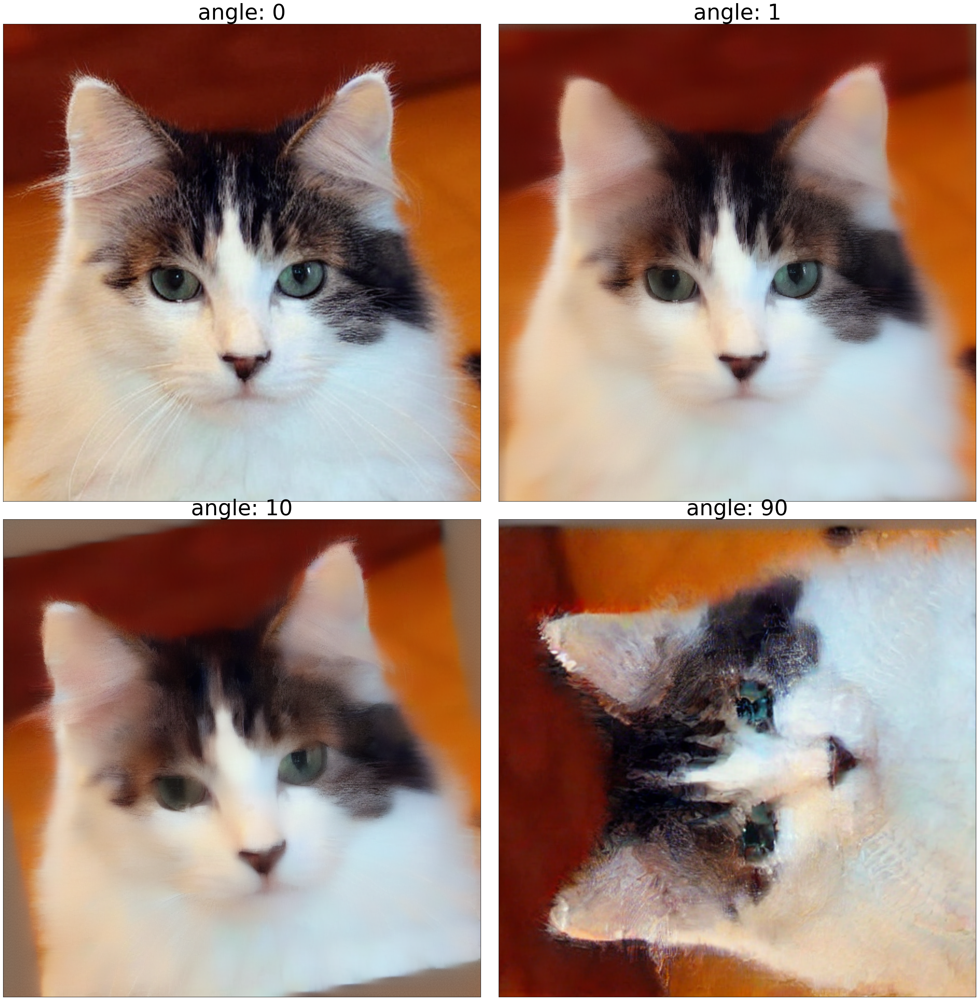

In [8]:
# Test padding="nearest"

TEST_ANGLES = [0, 1, 10, 90]
warped_imgs = []

for ang in TEST_ANGLES:
    angle = (torch.ones(1) * ang).to(device)
    scale = torch.ones(1).to(device)
    center = torch.ones(1, 2)
    center[..., 0] = latent.shape[3] / 2  # x
    center[..., 1] = latent.shape[2] / 2  # y

    rigid_mat = warper.get_rotation_matrix2d(center=center.to(device), 
                                              angle=angle.to(device), 
                                              scale=scale.to(device))

    _, _, src_h, src_w = latent.shape
    warped_latent = warper.warp_affine(latent, 
                                       rigid_mat, 
                                       dsize=(src_h, src_w), 
                                       interpolation_mode="bilinear", 
                                       padding_mode="zeros",
                                       verbose=False)

    warped_imgs.append(torch_to_pil(latent2image(warped_latent, vae)))
    
fig, axs = plt.subplots(2, 2, figsize=(32,32))
axs = axs.flatten()
fig.tight_layout()
_i = 0
for _i, (img, ax) in enumerate(zip(warped_imgs, axs)):
    ax.imshow(img)
    ax.set_title("angle: " + str(TEST_ANGLES[_i]), size=50)
    ax.set_xticks([])
    ax.set_yticks([])


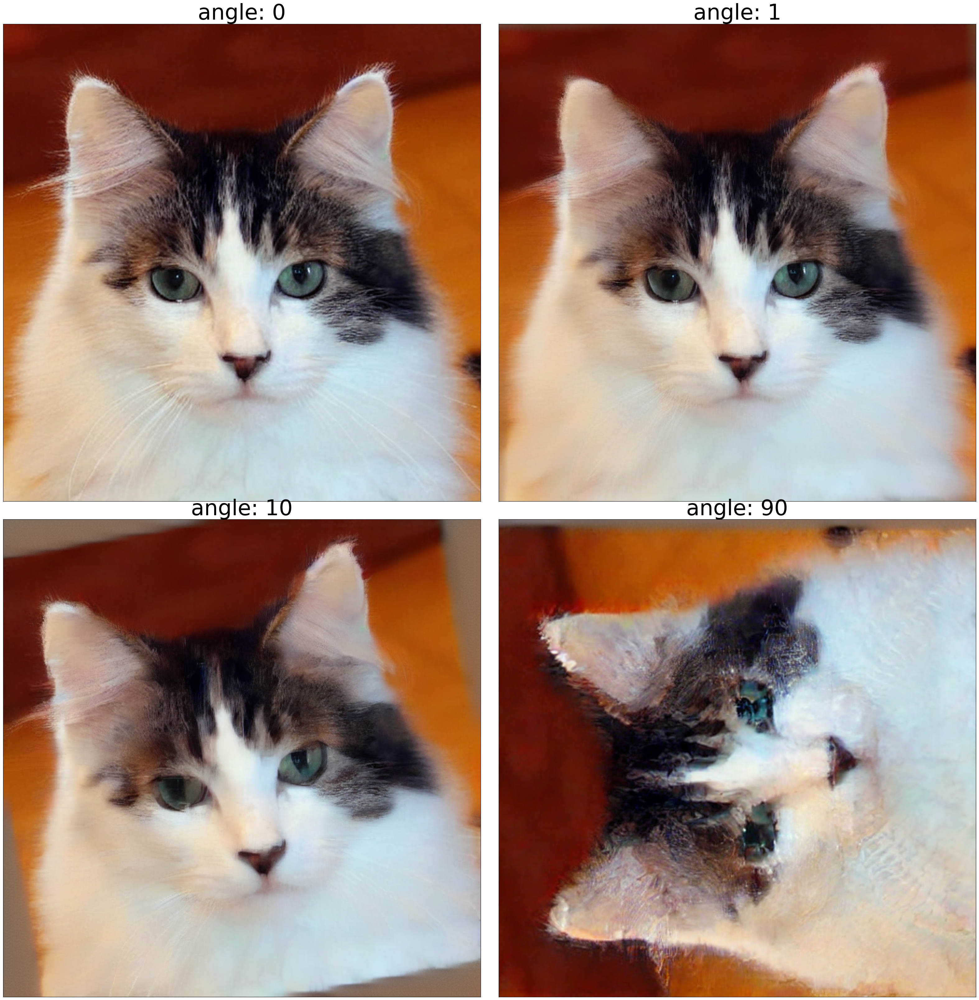

In [9]:
# Test padding="nearest"

TEST_ANGLES = [0, 1, 10, 90]
warped_imgs = []

for ang in TEST_ANGLES:
    angle = (torch.ones(1) * ang).to(device)
    scale = torch.ones(1).to(device)
    center = torch.ones(1, 2)
    center[..., 0] = latent.shape[3] / 2  # x
    center[..., 1] = latent.shape[2] / 2  # y

    rigid_mat = warper.get_rotation_matrix2d(center=center.to(device), 
                                              angle=angle.to(device), 
                                              scale=scale.to(device))

    _, _, src_h, src_w = latent.shape
    warped_latent = warper.warp_affine(latent, 
                                       rigid_mat, 
                                       dsize=(src_h, src_w), 
                                       interpolation_mode="bicubic", 
                                       padding_mode="zeros",
                                       verbose=False)

    warped_imgs.append(torch_to_pil(latent2image(warped_latent, vae)))
    
fig, axs = plt.subplots(2, 2, figsize=(32,32))
axs = axs.flatten()
fig.tight_layout()
_i = 0
for _i, (img, ax) in enumerate(zip(warped_imgs, axs)):
    ax.imshow(img)
    ax.set_title("angle: " + str(TEST_ANGLES[_i]), size=50)
    ax.set_xticks([])
    ax.set_yticks([])


Mean pixel difference tensor(-0.0066, device='cuda:4', grad_fn=<MeanBackward0>)


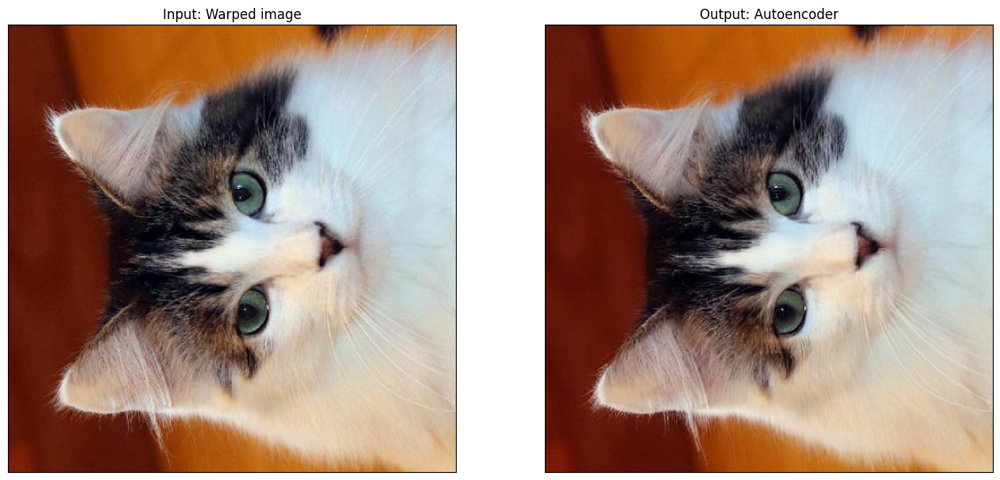

In [10]:
img = Image.open("/home/jh27kim/warp_latent/dataset/afhq/val/cat/image/flickr_cat_000008.jpg")
img = (np.array(img) / 255.0).astype(np.float32)
img = torch.tensor(img).permute(2, 0, 1).unsqueeze(0).to(device)

angle = (torch.ones(1) * ang).to(device)
scale = torch.ones(1).to(device)
center = torch.ones(1, 2)
center[..., 0] = img.shape[3] / 2  # x
center[..., 1] = img.shape[2] / 2  # y

rigid_mat = warper.get_rotation_matrix2d(center=center.to(device), 
                                         angle=angle.to(device), 
                                         scale=scale.to(device))

_, _, src_h, src_w = img.shape
warped_image = warper.warp_affine(img, 
                                  rigid_mat, 
                                  dsize=(src_h, src_w), 
                                  interpolation_mode="bicubic", 
                                  padding_mode="zeros",
                                  verbose=False)

fig, axs = plt.subplots(1, 2, figsize=(16, 16))
axs[0].imshow(torch_to_pil(warped_image))
axs[0].set_title("Input: Warped image")
axs[0].set_xticks([])
axs[0].set_yticks([])

recon_img = latent2image(image2latent(warped_image, vae), vae)
axs[1].imshow(torch_to_pil(recon_img))
axs[1].set_title("Output: Autoencoder")
axs[1].set_xticks([])
axs[1].set_yticks([])
print("Mean pixel difference", torch.mean(recon_img - warped_image))

In [43]:
import copy

def zero_out_latent(latent, delta):
    _, _, src_h, src_w = latent.shape
    new_latent = torch.zeros_like(latent).to(latent)
    
    low_h, high_h = src_h//2 - delta, src_h//2 + delta
    low_w, high_w = src_w//2 - delta, src_w//2 + delta
    
    new_latent[..., low_h:high_h, low_w:high_w] = latent[..., low_h:high_h, low_w:high_w]
    
    return new_latent

[]

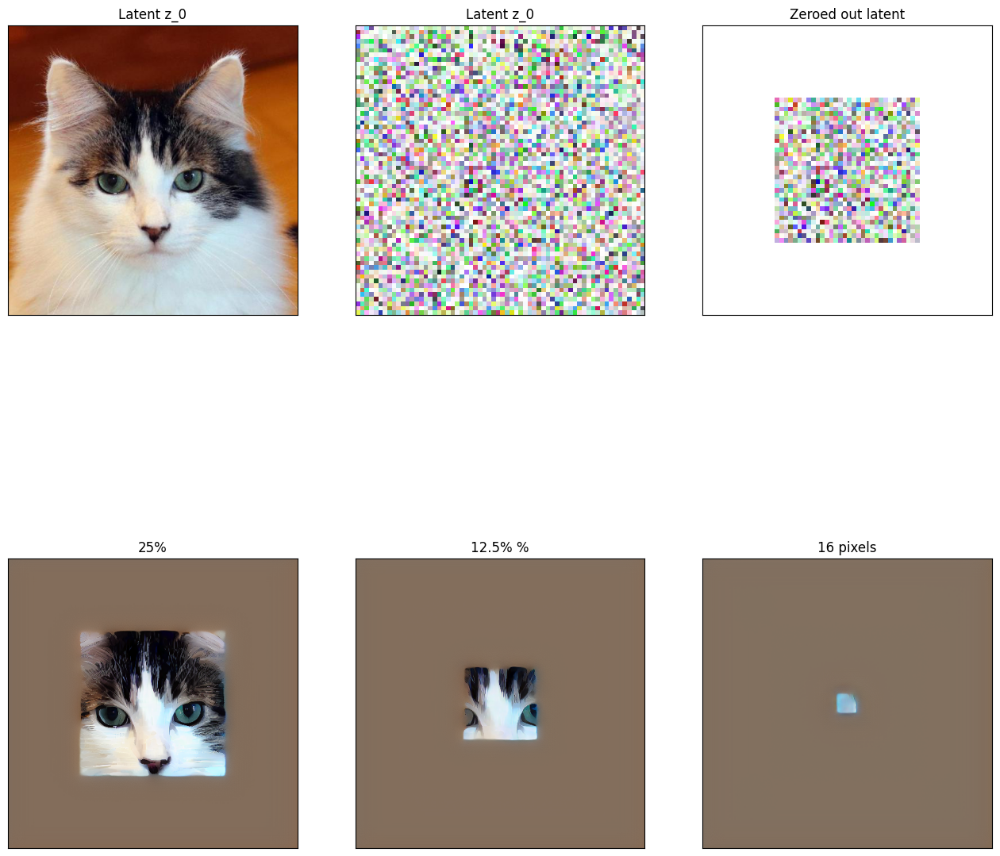

In [45]:
latent = image2latent(img, vae)
fig, axs = plt.subplots(2, 3, figsize=(16, 16))
axs[0][0].imshow(torch_to_pil(img))
axs[0][0].set_title("Latent z_0")
axs[0][0].set_xticks([])
axs[0][0].set_yticks([])

axs[0][1].imshow(torch_to_pil(latent))
axs[0][1].set_title("Latent z_0")
axs[0][1].set_xticks([])
axs[0][1].set_yticks([])

_, _, src_h, src_w = latent.shape
copy_latent = copy.deepcopy(latent)

# 25 % 
latent = zero_out_latent(copy_latent, 16)
axs[0][2].imshow(torch_to_pil(latent))
axs[0][2].set_title("Zeroed out latent")
axs[0][2].set_xticks([])
axs[0][2].set_yticks([])

axs[1][0].imshow(torch_to_pil(latent2image(latent, vae)))
axs[1][0].set_title("25%")
axs[1][0].set_xticks([])
axs[1][0].set_yticks([])

# 12.5 % 
latent = zero_out_latent(copy_latent, 8)
axs[1][1].imshow(torch_to_pil(latent2image(latent, vae)))
axs[1][1].set_title("12.5% %")
axs[1][1].set_xticks([])
axs[1][1].set_yticks([])

# 6.25 %
latent = zero_out_latent(copy_latent, 2)
axs[1][2].imshow(torch_to_pil(latent2image(latent, vae)))
axs[1][2].set_title("16 pixels")
axs[1][2].set_xticks([])
axs[1][2].set_yticks([])